<h1><center>VGG16识别岩石样本</center></h1>

In [1]:
# 导包
import os
import keras as K
import numpy as np
import pandas as pd
import tensorflow as tf
from keras import models,layers 
from sklearn.model_selection import train_test_split
from keras.applications.vgg16 import preprocess_input,decode_predictions
from keras.callbacks import ModelCheckpoint
from keras.models import load_model
from PIL import Image
from matplotlib import pyplot as plt 
%matplotlib inline 


Using TensorFlow backend.


In [2]:
# # 边运行代码，边释放显存，避免显存不够
# physical_devices = tf.config.experimental.list_physical_devices('GPU')
# assert len(physical_devices) > 0, "Not enough GPU hardware devices available"
# tf.config.experimental.set_memory_growth(physical_devices[0], True)

In [3]:
# 读取VGG16网络权重
a = np.load('vgg16.npy',encoding = 'latin1',allow_pickle = 1)
a = a.tolist()
a.keys()

dict_keys(['conv5_1', 'fc6', 'conv5_3', 'conv5_2', 'fc8', 'fc7', 'conv4_1', 'conv4_2', 'conv4_3', 'conv3_3', 'conv3_2', 'conv3_1', 'conv1_1', 'conv1_2', 'conv2_2', 'conv2_1'])

In [4]:
# ImageNet数据集的三通道均值
VGG_MEAN = [103.939, 116.779, 123.68]
           # B        G        R  


# 归一化，并且把输入的图片从RGB模式改为BGR模式
def imgsub(img):
    img_res = np.zeros(img.shape)          # R G B
    img_res[:,:,0] = img[:,:,2]-VGG_MEAN[0]# B = B - B
    img_res[:,:,1] = img[:,:,1]-VGG_MEAN[1]# G = G - G
    img_res[:,:,2] = img[:,:,0]-VGG_MEAN[2]# R = R - R
    return img_res  # B G R

## 模型网络搭建

In [5]:
# 搭建VGG16网络

def rock_VGG():
    model = models.Sequential()
    model.add(layers.Conv2D(64,(3,3),padding = 'same',activation = 'relu',name = 'conv1_1',input_shape = (224,224,3)))
    model.add(layers.Conv2D(64,(3,3),padding = 'same',activation = 'relu',name = 'conv1_2'))
    model.add(layers.MaxPooling2D((2,2),name = 'pool_1'))
    model.add(layers.Conv2D(128,(3,3),padding = 'same',activation = 'relu',name = 'conv2_1'))
    model.add(layers.Conv2D(128,(3,3),padding = 'same',activation = 'relu',name = 'conv2_2'))
    model.add(layers.MaxPooling2D((2,2),name = 'pool_2'))
    model.add(layers.Conv2D(256,(3,3),padding = 'same',activation = 'relu',name = 'conv3_1'))
    model.add(layers.Conv2D(256,(3,3),padding = 'same',activation = 'relu',name = 'conv3_2'))
    model.add(layers.Conv2D(256,(3,3),padding = 'same',activation = 'relu',name = 'conv3_3'))
    model.add(layers.MaxPooling2D((2,2),name = 'pool_3'))
    model.add(layers.Conv2D(512,(3,3),padding = 'same',activation = 'relu',name = 'conv4_1'))
    model.add(layers.Conv2D(512,(3,3),padding = 'same',activation = 'relu',name = 'conv4_2'))
    model.add(layers.Conv2D(512,(3,3),padding = 'same',activation = 'relu',name = 'conv4_3'))
    model.add(layers.MaxPooling2D((2,2),name = 'pool_4'))
    model.add(layers.Conv2D(512,(3,3),padding = 'same',activation = 'relu',name = 'conv5_1'))
    model.add(layers.Conv2D(512,(3,3),padding = 'same',activation = 'relu',name = 'conv5_2'))
    model.add(layers.Conv2D(512,(3,3),padding = 'same',activation = 'relu',name = 'conv5_3'))
    model.add(layers.MaxPooling2D((2,2),name = 'pool_5'))
    model.add(layers.Flatten(name = 'flatten'))
    model.add(layers.Dense(4096,activation='relu',name = 'fc6'))
#     model.add(layers.Dense(4096,activation='relu',name = 'fc7'))
    model.add(layers.Dense(7,activation='softmax',name = 'fc8'))
    return model  

## 模型训练

In [6]:
# 载入训练数据
rock_path = './train_1'
label_path = './label_new.csv'
label = pd.read_csv(label_path)


img_pathes = ['{}-1.bmp'.format(i) if i<=320 else '{}-1.jpg'.format(i) for i in label['样本编号']  ]
img_pathes = [os.path.join(rock_path,i) for i in img_pathes]# 补全路径,全部图片的路径
label = label['类别标签']
label = list(label)


In [7]:
# # 数据增强1
# from keras.preprocessing.image import ImageDataGenerator
# img_gene = ImageDataGenerator(rotation_range = 90)

In [8]:
# # torch数据增强
# train_loader = torch.utils.data.DataLoader(
#     datasets.MNIST('../data', train=True, download=True,
#                    transform=transforms.Compose([
#                        transforms.RandomHorizontalFlip(),
#                        transforms.RandomVerticalFlip(),
#                        transforms.RandomRotation(15),
#                        transforms.RandomRotation([90, 180, 270]),
#                        transforms.Resize([32, 32]),
#                        transforms.RandomCrop([28, 28]),
#                        transforms.ToTensor(),
#                        # transforms.Normalize((0.1307,), (0.3081,))
#                    ])),
#     batch_size=batch_size, shuffle=True)

In [9]:
# 分割训练集和测试集
val_ratio = 0.2
x_train, x_val, y_train, y_val = train_test_split(img_pathes, label, test_size=val_ratio, 
                                                  random_state=42, shuffle=True, stratify=label)

In [10]:
# 定义生成器，用于训练时batch的生成（小批量生成可以避免内存不够）
def Generator(img_set,labels,batch_size):
    while True:
        img_batch = []
        label_batch = []
        for i in range(len(img_set)):
            img_path = img_set[i]
            img = Image.open(img_path)
            img = img.convert('RGB')
            img = img.resize((224,224))
            img = np.asarray(img)
            img = imgsub(img)
            img_batch.append(img)

            label = labels[i]
            label_batch.append(label)
            if (i+1)%batch_size==0 or (i+1) == len(img_set):# 凑够batch_size张图片的矩阵
                img_batch = np.array(img_batch) # 拼成一个大矩阵，用于训练
                label_batch = np.array(label_batch)
                label_batch = K.utils.to_categorical(label_batch, num_classes=7)
                yield img_batch,label_batch

                img_batch = []
                label_batch = []

In [11]:
if os.path.exists('Best_rock_Model-jingdong.h5'):
    model_Best = 'Best_rock_Model-jingdong.h5'
    model = load_model(model_Best)
else:
    model = rock_VGG()
    
    # 设置网络权重
    for a_name in a.keys():
        if a_name in ['fc6', 'fc7', 'fc8']:
            continue
        layer = model.get_layer(a_name)
        a_corresponding_layer = a[a_name]
        layer.set_weights(a_corresponding_layer)

    
# 断点续训
checkpoint = ModelCheckpoint('Best_rock_Model-jingdong.h5', verbose=1, monitor='val_accuracy', 
                             save_best_only=True, mode='max')

# 指定模型的损失函数，优化器，衡量指标
model.compile(loss='categorical_crossentropy', optimizer=K.optimizers.Adamax(lr=1e-4),
              metrics=['accuracy'])

# 模型训练
batch_size = 15
model.fit(Generator(x_train, y_train, batch_size),
          steps_per_epoch=len(x_train)//batch_size,
          epochs=20,
          validation_data=Generator(x_val, y_val, batch_size),
          validation_steps=len(x_val) // batch_size,
          callbacks=[checkpoint])

Epoch 1/20
 6/16 [==========>...................] - ETA: 2:53 - loss: 2.9174 - accuracy: 0.3111

KeyboardInterrupt: 

## 模型预测

In [33]:
# 载入图片,进行预测
r = './rock/1-1.bmp'
img = Image.open(r)
img = img.resize((224,224))
img = np.array(img)
img = img[:,:,:3]
img = imgsub(img)
img = np.expand_dims(img,axis = 0 )


if os.path.exists('Best_rock_Model.h5'):
    model_Best = 'Best_rock_Model.h5'
    model = load_model(model_Best)

res = model.predict(img)

# 预测结果
print('Results are',res)

Results are [[4.8111647e-04 4.0560673e-05 2.4081945e-05 9.9779874e-01 7.8758673e-04
  8.6640246e-04 1.5864492e-06]]


### 预测结果可视化

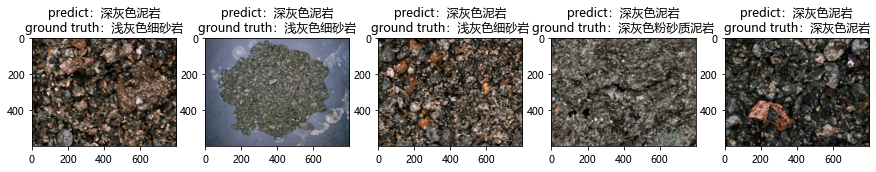

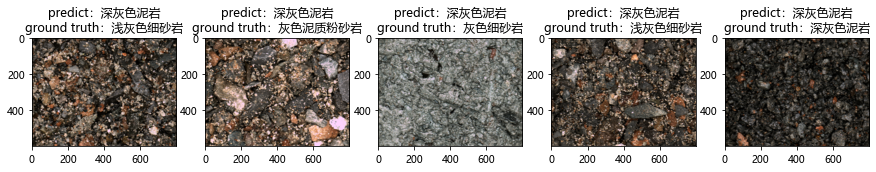

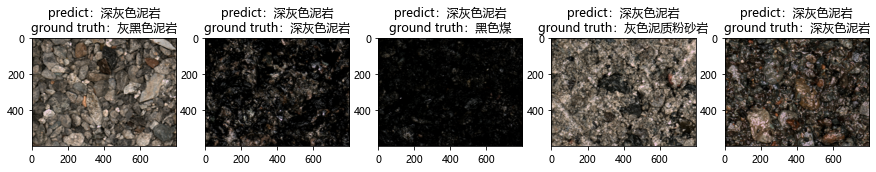

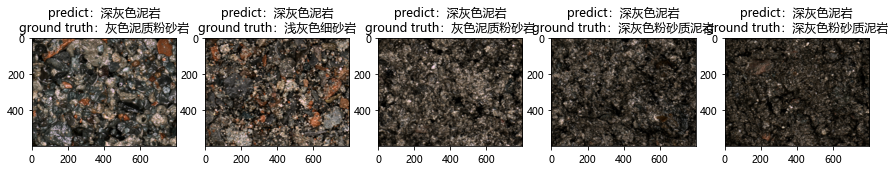

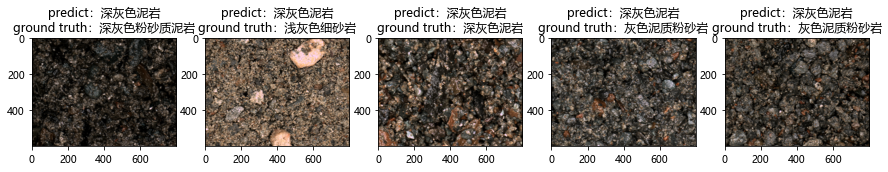

...

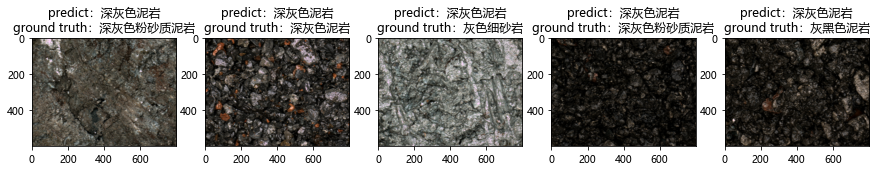

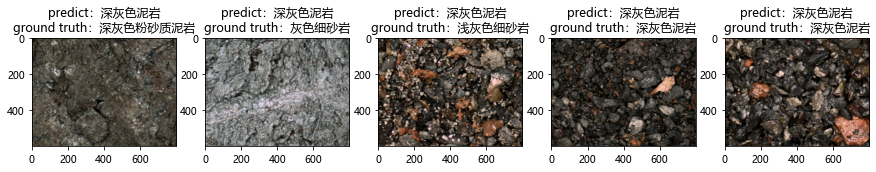

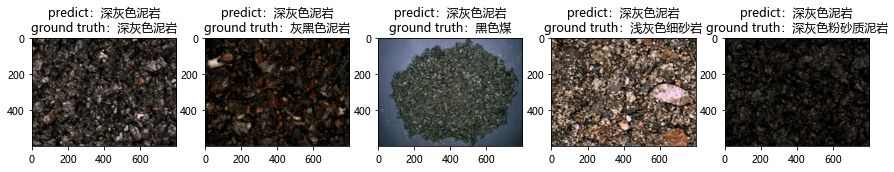

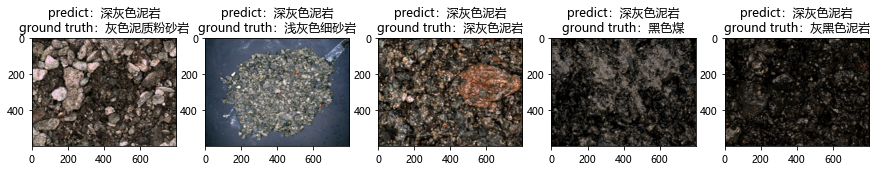

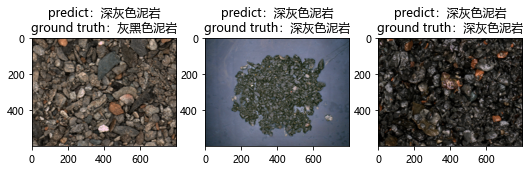

In [38]:
# plt绘图中显示中文和符号
plt.rcParams['font.sans-serif'] = ['Microsoft YaHei']
plt.rcParams['axes.unicode_minus'] = False 

df_label = pd.read_csv('label_new.csv')

# fig = plt.figure(figsize = (15,4*315))
for i in range(len(x_val)):
    img_show_name = x_val[i]
    img_show_num = os.path.split(img_show_name)[-1].split('-')[0]
    img_show_num = int(img_show_num)
    
    # 利用样本编号（文件名,x_val）与样本类别的对应关系
    label_show_chinese = df_label['样本类别'][df_label['样本编号']==img_show_num]
    label_show_chinese = label_show_chinese.iloc[0]
    
    img = Image.open(img_show_name).convert('RGB')
    img = img.resize((224,224))
    img = np.array(img)
    img_plot = img.copy()
    
    img = imgsub(img)
    img = np.expand_dims(img,axis = 0 )
    predict = model.predict(img)
    predict_num = np.argmax(res)
    predict_chinese = df_label['样本类别'][df_label['类别标签']==predict_num].iloc[0]# 得到预测结果的中文
    
    #ax = fig.add_subplot(315,5,i+1)
    if i%5==0:
        plt.figure(figsize = (15,3))
    plt.subplot(1,5,i%5+1)
    img_plot = Image.fromarray(img_plot).resize((800,600))
    img_plot = np.array(img_plot)
    plt.imshow(img_plot)
    plt.title(f'predict：{predict_chinese}\nground truth：{label_show_chinese}')
    

# 检查数据生成

In [12]:
# 定义生成器，用于训练时batch的生成（小批量生成可以避免内存不够）
import time 
def Generator(img_set,labels,batch_size):
    while True:
        img_batch = []
        label_batch = []
        path_batch = []
        time_begin = time.time()
        for i in range(len(img_set)):
            img_path = img_set[i]
            img = Image.open(img_path)
            img = img.convert('RGB')
            img = img.resize((224,224))
            img = np.asarray(img)
            img = imgsub(img)
            img_batch.append(img)

            label = labels[i]
            label_batch.append(label)
            
            path_batch.append(img_path)
            if (i+1)%batch_size==0 or (i+1) == len(img_set):# 凑够batch_size张图片的矩阵
                time_end = time.time()
                img_batch = np.array(img_batch) # 拼成一个大矩阵，用于训练
                label_batch = np.array(label_batch)
                label_batch = K.utils.to_categorical(label_batch, num_classes=7)
                print('time used is ',time_end - time_begin)
                yield path_batch,img_batch,label_batch

                img_batch = []
                label_batch = []
                path_batch = []
                time_begin = time.time()

In [ ]:
g_train = Generator(x_val,y_val,5)
for path_batch,img_batch,label in g_train:
    print('-'*100)
    print(path_batch,'\n',label)


time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49111151695251465
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340754508972168
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5390472412109375
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320755958557129
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631279945373535
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221190452575684
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33307623863220215
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541253089904785
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5261187553405762
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5501246452331543
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5651280879974365
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5471246242523193
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3500790596008301
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5291194915771484
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5361254215240479
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.b

time used is  0.5231177806854248
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5691289901733398
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34807825088500977
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591270923614502
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.514230489730835
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3360762596130371
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5570428371429443
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5621273517608643
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.547123908996582
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3390769958496094
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5263471603393555
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.556126594543457
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3360762596130371
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571267604827881
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5311179161071777
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'

time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33307671546936035
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5141172409057617
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551257133483887
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141172409057617
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5661287307739258
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5491242408752441
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5731303691864014
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3390767574310303
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5551261901855469
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5341207981109619
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5381224155426025
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5451233386993408
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5321202278137207
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3500790596008301
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451240539550781
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051138401031494
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.531121015548706
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5221192836761475
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33507633209228516
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.555126428604126
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031170845031738
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5031137466430664
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.555126428604126
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121166706085205
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5241196155548096
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5451240539550781
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.541123628616333
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481240749359131
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.338076114654541
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.

time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5321214199066162
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5061168670654297
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5241196155548096
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3380765914916992
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421252250671387
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 

time used is  0.34607839584350586
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5091161727905273
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.b

time used is  0.560126543045044
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.504115104675293
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp']

time used is  0.5721304416656494
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.35107946395874023
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091149806976318
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151176452636719
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5081157684326172
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101165771484375
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007763862609863
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5111169815063477
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231180191040039
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.524118185043335
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.336076021194458
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5581262111663818
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5401229858398438
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5551249980926514
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131170749664307
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5511255264282227
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207773208618164
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407758712768555
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.55812668800354
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1.

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.522120475769043
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.542123556137085
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.3450779914855957
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241184234619141
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5531251430511475
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.542123556137085
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3450784683227539
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.513333797454834
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5152218341827393
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'

time used is  0.5391228199005127
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007692337036133
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481250286102295
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3390772342681885
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511245727539062
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491242408752441
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.554126501083374
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5481245517730713
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007716178894043
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.b

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp']

time used is  0.5461235046386719
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410770893096924
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5241210460662842
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551259517669678
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.345078706741333
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571262836456299
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151162147521973
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5581264495849609
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5591268539428711
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131170749664307
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5393948554992676
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407711029052734
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5139977931976318
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5581262111663818
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707642555236816
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5641276836395264
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5111165046691895
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp']

time used is  0.5062782764434814
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341215133666992
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3340761661529541
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5641283988952637
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251197814941406
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071144104003906
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5471236705780029
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5471248626708984
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607791900634766
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061154365539551
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201187133789062
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511248111724854
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421230792999268
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221178531646729
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3430812358856201
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.55812668800354
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451233386993408
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp

time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5581264495849609
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111169815063477
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5611269474029541
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410773277282715
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5131158828735352
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5521261692047119
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.332075834274292
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591261386871338
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511245727539062
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251824855804443
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp']

time used is  0.3470785617828369
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5631279945373535
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171167850494385
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5401220321655273
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5551259517669678
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307600021362305
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'

time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207773208618164
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551254749298096
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp']

time used is  0.3470785617828369
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5521249771118164
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5621271133422852
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071158409118652
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5541255474090576
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.547123908996582
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3390769958496094
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3450784683227539
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5110454559326172
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361220836639404
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5311198234558105
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031149387359619
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207725524902344
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5081160068511963
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5551259517669678
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231211185455322
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5581271648406982
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.546391487121582
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410773277282715
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5085241794586182
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311200618743896
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430783748626709
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5453977584838867
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33707666397094727
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631282329559326
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5741267204284668
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481247901916504
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5156235694885254
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5605473518371582
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5581264495849609
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207797050476074
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5411233901977539
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251197814941406
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261187553405762
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5591270923614502
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407854080200195
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5731296539306641
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5331213474273682
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3390774726867676
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551261901855469
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5221190452575684
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.560126543045044
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp

time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5230915546417236
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5471236705780029
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3450782299041748
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111167430877686
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5691280364990234
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507680892944336
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591263771057129
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5581269264221191
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5231180191040039
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151162147521973
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471243858337402
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5681290626525879
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5121171474456787
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.530120849609375
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5131173133850098
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.530120849609375
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp']

time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511252880096436
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507609367370605
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171167850494385
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5511252880096436
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.35708093643188477
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5151176452636719
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591270923614502
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207773208618164
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631272792816162
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541267395019531
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5581264495849609
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 


time used is  0.5131173133850098
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.554126501083374
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5631275177001953
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3500797748565674
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211176872253418
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5161166191101074
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007716178894043
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591268539428711
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34407711029052734
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531258583068848
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491242408752441
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261201858520508
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707690238952637
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.531120777130127
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131170749664307
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.529120683670044
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.535120964050293
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5571255683898926
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307528495788574
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521247386932373
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561261177062988
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34407854080200195
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541262626647949
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5341215133666992
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5551254749298096
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5631282329559326
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3380768299102783
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.525118350982666
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 

time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.36208200454711914
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5271203517913818
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071144104003906
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221140384674072
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.3430781364440918
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5881328582763672
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5771312713623047
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5281057357788086
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5501246452331543
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211174488067627
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5581271648406982
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511252880096436
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607887268066406
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5371222496032715
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5341207981109619
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401225090026855
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407830238342285
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521249771118164
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561268329620361
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.55812668800354
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5141172409057617
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241196155548096
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.6131389141082764
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5581271648406982
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5661284923553467
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3560810089111328
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5392234325408936
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5321202278137207
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5541255474090576
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007692337036133
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591268539428711
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541255474090576
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3470790386199951
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5651285648345947
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551254749298096
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp

time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251216888427734
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331206321716309
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5273804664611816
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5551259517669678
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340764045715332
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5161166191101074
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.b

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.555126428604126
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.336076021194458
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.55812668800354
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0

time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.556126594543457
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5145316123962402
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5081157684326172
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33507585525512695
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.548123836517334
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.501112699508667
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.b

time used is  0.5471246242523193
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.543123722076416
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.345078706741333
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.

time used is  0.5261199474334717
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430783748626709
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451233386993408
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5001132488250732
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.525118350982666
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.34407806396484375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541262626647949
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551257133483887
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5551261901855469
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5311200618743896
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5401210784912109
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5521254539489746
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5461244583129883
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5551259517669678
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320751190185547
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.523118257522583
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3421773910522461
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381224155426025
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5405700206756592
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3390769958496094
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5211176872253418
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5201818943023682
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bm

time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451242923736572
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207725524902344
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5181169509887695
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410775661468506
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401229858398438
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5331451892852783
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5371222496032715
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5461235046386719
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.3410770893096924
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.542123556137085
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411231517791748
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5063834190368652
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221192836761475
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5562689304351807
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.32607436180114746
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 


time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp']

time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34908127784729004
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.535120964050293
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5143351554870605
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.32607436180114746
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521254539489746
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111179351806641
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5143887996673584
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5401225090026855
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.540123462677002
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.549124002456665
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410778045654297
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.

time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5111165046691895
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.504115104675293
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007740020751953
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471231937408447
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3360764980316162
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511279106140137
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551257133483887
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.b

time used is  0.5461242198944092
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511252880096436
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3380770683288574
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5101163387298584
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 


time used is  0.5231192111968994
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5001130104064941
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007787704467773
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.33507633209228516
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591273307800293
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5151176452636719
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141174793243408
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 

time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5471236705780029
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp']

time used is  0.5371227264404297
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307552337646484
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191166400909424
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211176872253418
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp']

time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007740020751953
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421230792999268
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5155544281005859
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5191199779510498
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121157169342041
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34407782554626465
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.560126781463623
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 

time used is  0.5211188793182373
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5101163387298584
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5183768272399902
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5511248111724854
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281190872192383
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081157684326172
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3390769958496094
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5751307010650635
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5142943859100342
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3410770893096924
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491242408752441
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5251197814941406
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5521254539489746
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221178531646729
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121169090270996
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5621280670166016
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3470785617828369
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.541123628616333
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007692337036133
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5364046096801758
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp']

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.33507609367370605
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141160488128662
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5241179466247559
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5471246242523193
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3324739933013916
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3560810089111328
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401220321655273
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5191192626953125
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.511115312576294
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3410773277282715
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451233386993408
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5204665660858154
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081157684326172
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.555126428604126
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430781364440918
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061354637145996
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp']

time used is  0.548123836517334
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.334075927734375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5661277770996094
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1.

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471243858337402
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp']

time used is  0.5223400592803955
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34407806396484375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451231002807617
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5441231727600098
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5154075622558594
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.338076114654541
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.5131158828735352
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5201172828674316
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307552337646484
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3410770893096924
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411224365234375
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.b

time used is  0.5661284923553467
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5101163387298584
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271203517913818
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5043697357177734
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321202278137207
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5551257133483887
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507633209228516
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5091147422790527
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461235046386719
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.34407877922058105
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0

time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451240539550781
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5201187133789062
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3382093906402588
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211176872253418
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181169509887695
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501246452331543
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5521254539489746
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5091149806976318
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5412182807922363
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.514115571975708
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5611274242401123
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407806396484375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5151176452636719
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241222381591797
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5211188793182373
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071172714233398
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp']

time used is  0.5441238880157471
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507633209228516
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521254539489746
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081145763397217
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5081157684326172
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3410773277282715
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401225090026855
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451233386993408
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061156749725342
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.556126594543457
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5521249771118164
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207725524902344
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211176872253418
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5234544277191162
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.505115270614624
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5521256923675537
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307528495788574
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591273307800293
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611274242401123
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221190452575684
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051138401031494
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.34207797050476074
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541262626647949
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 


time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481247901916504
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430776596069336
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251197814941406
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381226539611816
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551257133483887
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5111186504364014
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207725524902344
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501244068145752
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.551123857498169
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'

time used is  0.5175046920776367
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5331203937530518
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231192111968994
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bm

time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5661280155181885
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5441238880157471
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5501246452331543
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381217002868652
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451242923736572
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5051140785217285
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3430776596069336
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201172828674316
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5501253604888916
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5191168785095215
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161178112030029
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410773277282715
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5134878158569336
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5102336406707764
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.b

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5112123489379883
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307576179504395
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481247901916504
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221178531646729
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061159133911133
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3450782299041748
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351207256317139
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441238880157471
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5461235046386719
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221192836761475
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 

time used is  0.5511260032653809
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5501241683959961
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3290748596191406
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 

time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051157474517822
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221176147460938
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp

time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5235764980316162
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.560126781463623
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34307050704956055
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.530120849609375
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.b

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5511255264282227
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007692337036133
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3430774211883545
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.531121015548706
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5601274967193604
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3470790386199951
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081160068511963
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp']

time used is  0.5651283264160156
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3380773067474365
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551259517669678
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461246967315674
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.34407806396484375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381224155426025
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5425052642822266
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.547123908996582
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091149806976318
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.568129301071167
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407782554626465
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.511115312576294
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5211176872253418
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381217002868652
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5521256923675537
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340761661529541
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431227684020996
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131170749664307
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.34322071075439453
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481245517730713
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5581262111663818
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5171165466308594
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5671288967132568
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 

time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5341215133666992
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410775661468506
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5141174793243408
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'

time used is  0.5611276626586914
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707642555236816
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5231192111968994
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511255264282227
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431227684020996
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 

time used is  0.5081145763397217
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5215551853179932
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.547123908996582
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5341207981109619
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407806396484375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081160068511963
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5311200618743896
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5031137466430664
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141172409057617
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561261177062988
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171191692352295
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251200199127197
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5071160793304443
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5111780166625977
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3320755958557129
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451228618621826
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5282771587371826
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041153430938721
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211200714111328
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5231192111968994
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.549124002456665
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5441238880157471
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5051140785217285
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607839584350586
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5526177883148193
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5041136741638184
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5041148662567139
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5211188793182373
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5081171989440918
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.524118185043335
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.555126428604126
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151176452636719
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5031144618988037
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp']

time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3300747871398926
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5051014423370361
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401232242584229
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5041139125823975
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231192111968994
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5191185474395752
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5621275901794434
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5471243858337402
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5056192874908447
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5541255474090576
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241184234619141
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5391216278076172
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507609367370605
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5021145343780518
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231180191040039
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5521259307861328
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607934951782227
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3450782299041748
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.523118257522583
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591261386871338
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5361220836639404
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5084719657897949
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bm

time used is  0.5431225299835205
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.336076021194458
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.

time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5311200618743896
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4991137981414795
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111165046691895
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5521254539489746
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3390769958496094
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451231002807617
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.523118257522583
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.549124002456665
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5041148662567139
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5201172828674316
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021145343780518
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3430774211883545
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471246242523193
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521256923675537
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541255474090576
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5441238880157471
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5401215553283691
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481245517730713
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.336076021194458
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.511115312576294
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 

time used is  0.5341215133666992
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5561258792877197
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107566833496094
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5255255699157715
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.535120964050293
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5021135807037354
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3470795154571533
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5001139640808105
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481240749359131
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5571269989013672
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430774211883545
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.

time used is  0.5003690719604492
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371212959289551
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107495307922363
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441226959228516
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5021145343780518
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.34207797050476074
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381228923797607
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5151162147521973
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bm

time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 


time used is  0.550246000289917
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607887268066406
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061142444610596
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211188793182373
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5451233386993408
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410773277282715
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.538123369216919
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381214618682861
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp']

time used is  0.5201187133789062
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3490786552429199
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551261901855469
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5252113342285156
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5821323394775391
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5761311054229736
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5291194915771484
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5621271133422852
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5651280879974365
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5661280155181885
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5781314373016357
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3650839328765869
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.547123908996582
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5371215343475342
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5189876556396484
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5091161727905273
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.531120777130127
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5541255474090576
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107519149780273
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5031137466430664
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5081157684326172
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221190452575684
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211174488067627
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3470783233642578
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.543123722076416
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531258583068848
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bm

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5561256408691406
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3300747871398926
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5161163806915283
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407830238342285
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5001134872436523
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5011141300201416
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5021133422851562
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.33107495307922363
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461242198944092
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331218242645264
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5571262836456299
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371222496032715
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001130104064941
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5461235046386719
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4991130828857422
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201187133789062
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061142444610596
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320751190185547
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631279945373535
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5341207981109619
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561261177062988
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3560800552368164
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5811316967010498
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611276626586914
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5551259517669678
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5151209831237793
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5591263771057129
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211191177368164
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291838645935059
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5541255474090576
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.560126543045044
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3450782299041748
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'

time used is  0.5574491024017334
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340761661529541
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5581264495849609
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5621275901794434
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5141174793243408
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.32807493209838867
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551261901855469
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5691285133361816
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351214408874512
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121152400970459
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5274374485015869
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5011134147644043
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5351221561431885
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5521261692047119
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3300747871398926
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5241184234619141
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.530120849609375
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5461242198944092
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3500795364379883
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5306270122528076
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391218662261963
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001132488250732
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3490781784057617
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.571129560470581
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5581264495849609
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101151466369629
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5183298587799072
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5461242198944092
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381214618682861
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407830238342285
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5411262512207031
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207725524902344
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5061154365539551
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031147003173828
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33707666397094727
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.4991130828857422
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.556126594543457
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [

time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5041139125823975
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.529120683670044
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5331215858459473
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201187133789062
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.560126781463623
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320753574371338
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49811291694641113
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031144618988037
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430774211883545
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531260967254639
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.334075927734375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5661287307739258
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5211191177368164
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281205177307129
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5571267604827881
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5521256923675537
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5621273517608643
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707690238952637
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3670833110809326
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631277561187744
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5261201858520508
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.512115478515625
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5190558433532715
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.3270742893218994
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5661275386810303
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.513115644454956
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611276626586914
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5351219177246094
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191187858581543
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5611279010772705
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5651280879974365
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.555126428604126
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.345078706741333
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.

time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5271189212799072
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5171167850494385
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141177177429199
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5111165046691895
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407734870910645
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391216278076172
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.34807872772216797
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421226024627686
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5441229343414307
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5161166191101074
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5631279945373535
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121157169342041
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.561126708984375
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451240539550781
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407854080200195
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3540799617767334
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541253089904785
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.511115312576294
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041148662567139
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3490791320800781
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401227474212646
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5641281604766846
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5051138401031494
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.504115104675293
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.556126594543457
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5641272068023682
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5361223220825195
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407782554626465
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.5041139125823975
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381226539611816
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5461242198944092
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3500795364379883
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521249771118164
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.524118185043335
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5040593147277832
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571262836456299
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33707666397094727
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611271858215332
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5101168155670166
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611274242401123
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5111165046691895
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5120670795440674
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5131158828735352
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5391228199005127
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5541255474090576
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5561261177062988
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430776596069336
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5381217002868652
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5551261901855469
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340754508972168
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.548123836517334
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211176872253418
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp']

time used is  0.3450784683227539
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441231727600098
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461235046386719
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5582606792449951
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141160488128662
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5481240749359131
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5561268329620361
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407806396484375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5261199474334717
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5401217937469482
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607911109924316
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451245307922363
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5091161727905273
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3430776596069336
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331213474273682
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5231177806854248
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5581264495849609
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5511248111724854
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111165046691895
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5401229858398438
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410775661468506
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5371222496032715
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3450784683227539
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421230792999268
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5281190872192383
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207773208618164
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341215133666992
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401229858398438
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461235046386719
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5631277561187744
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061154365539551
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5481240749359131
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5501253604888916
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407758712768555
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.531120777130127
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.b

time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5571269989013672
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3500795364379883
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5021133422851562
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371222496032715
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301194190979004
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.34007692337036133
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591270923614502
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611276626586914
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5651283264160156
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5341207981109619
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5390129089355469
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5591270923614502
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3630826473236084
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5371224880218506
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.349078893661499
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5071158409118652
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.536121129989624
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081145763397217
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33707642555236816
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631277561187744
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371215343475342
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5091149806976318
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211174488067627
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.560126543045044
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131170749664307
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5681290626525879
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3520801067352295
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3540804386138916
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.542123556137085
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071144104003906
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5341207981109619
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3390767574310303
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.556126594543457
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0.

time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501244068145752
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.566129207611084
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5661284923553467
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5401220321655273
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3470785617828369
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221178531646729
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.547123908996582
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3480796813964844
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.531121015548706
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281190872192383
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34807896614074707
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421226024627686
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5151162147521973
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.505115270614624
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021147727966309
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5601263046264648
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5591273307800293
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607815742492676
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5001132488250732
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34807848930358887
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421223640441895
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5091161727905273
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241184234619141
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3250739574432373
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5061919689178467
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5671286582946777
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 


time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5021135807037354
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5480616092681885
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5441243648529053
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3560805320739746
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5031137466430664
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5321202278137207
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5061156749725342
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4921121597290039
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371215343475342
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5601274967193604
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107566833496094
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611274242401123
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5081160068511963
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5011134147644043
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4991133213043213
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34407830238342285
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5591268539428711
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5001142024993896
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021135807037354
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051140785217285
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.559126615524292
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5501244068145752
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707642555236816
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.b

time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5401227474212646
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34907984733581543
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571262836456299
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3320753574371338
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631279945373535
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371215343475342
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 


time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221192836761475
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.540123462677002
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3250739574432373
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0.

time used is  0.5161163806915283
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5511252880096436
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430781364440918
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591263771057129
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5261185169219971
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481240749359131
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.345078706741333
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341217517852783
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.561126708984375
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5021147727966309
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5051155090332031
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp']

time used is  0.560126781463623
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351221561431885
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34807872772216797
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211193561553955
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5401229858398438
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34807825088500977
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5290322303771973
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3500792980194092
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5341207981109619
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181164741516113
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5401229858398438
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131170749664307
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.562126874923706
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3270745277404785
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261199474334717
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5031147003173828
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341207981109619
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5601272583007812
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307552337646484
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5211188793182373
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5080184936523438
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5291194915771484
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.504115104675293
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.34807872772216797
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481247901916504
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5321216583251953
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5021135807037354
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361208915710449
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5571267604827881
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707642555236816
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5331215858459473
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3540799617767334
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5411219596862793
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111150741577148
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3320755958557129
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5641281604766846
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001134872436523
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.496112585067749
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5641279220581055
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5670473575592041
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.32407307624816895
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3540802001953125
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5011143684387207
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.505115270614624
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.555126428604126
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp

time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021135807037354
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.55812668800354
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp']

time used is  0.5591270923614502
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.35308003425598145
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241184234619141
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331799983978271
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5441238880157471
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3360764980316162
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.571129322052002
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp']

time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281205177307129
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3700833320617676
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401229858398438
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5531258583068848
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5401225090026855
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320753574371338
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371212959289551
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307552337646484
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5031149387359619
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5311198234558105
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5001134872436523
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5161166191101074
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3450777530670166
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391230583190918
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5611279010772705
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5501246452331543
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34807920455932617
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 


time used is  0.49811434745788574
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5481233596801758
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340756893157959
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611271858215332
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5381224155426025
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5011131763458252
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5581264495849609
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33307647705078125
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521247386932373
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5351221561431885
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5411224365234375
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5631277561187744
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340756893157959
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5521254539489746
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307528495788574
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451240539550781
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5001130104064941
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5130293369293213
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181169509887695
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34807920455932617
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361220836639404
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341217517852783
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5591275691986084
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511252880096436
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3380768299102783
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp']

time used is  0.5541262626647949
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607863426208496
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5231194496154785
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531268119812012
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5331206321716309
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3450782299041748
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631277561187744
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591270923614502
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.571129560470581
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5001130104064941
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.523118257522583
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.b

time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5721297264099121
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407806396484375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4971122741699219
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340756893157959
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631279945373535
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.571129322052002
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5451240539550781
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171167850494385
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.33307504653930664
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561258792877197
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031144618988037
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501244068145752
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5341205596923828
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5091521739959717
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231177806854248
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.530120849609375
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361227989196777
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5011143684387207
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5641279220581055
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3360764980316162
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5070266723632812
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3490779399871826
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5200817584991455
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.33307623863220215
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561258792877197
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041148662567139
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5201187133789062
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5341215133666992
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041139125823975
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5321199893951416
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5581271648406982
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3250730037689209
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221178531646729
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181164741516113
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34907960891723633
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451240539550781
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5391218662261963
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33307576179504395
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531253814697266
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611262321472168
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.541123628616333
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.531120777130127
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5561261177062988
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281190872192383
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5631279945373535
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491242408752441
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3470792770385742
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5331206321716309
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041148662567139
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151162147521973
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307600021362305
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5692126750946045
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.560126781463623
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.511115312576294
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341205596923828
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5031137466430664
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3340756893157959
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521254539489746
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271189212799072
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5021147727966309
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5481240749359131
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3400766849517822
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241184234619141
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.49811339378356934
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4941117763519287
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.b

time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3450784683227539
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.531120777130127
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471246242523193
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5371215343475342
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3390777111053467
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021133422851562
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591268539428711
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5361206531524658
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5341217517852783
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5411224365234375
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519097089767456
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5501246452331543
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481245517730713
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.334075927734375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251185894012451
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5631270408630371
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.32907533645629883
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.529155969619751
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 

time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3520796298980713
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351214408874512
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5641281604766846
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.511115312576294
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 

time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5521247386932373
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5601274967193604
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34907960891723633
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 


time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5011143684387207
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.536121129989624
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34907960891723633
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.49811387062072754
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041139125823975
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271189212799072
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33507561683654785
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471248626708984
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461242198944092
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5461244583129883
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211188793182373
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5501244068145752
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410775661468506
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5281205177307129
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211176872253418
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111167430877686
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5481240749359131
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.345078706741333
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561258792877197
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5641279220581055
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.33707690238952637
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591270923614502
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5621263980865479
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4991133213043213
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.b

time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.548123836517334
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101151466369629
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5401227474212646
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407830238342285
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 

time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.32907533645629883
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041136741638184
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5211176872253418
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5110418796539307
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.536121129989624
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211191177368164
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5231196880340576
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49311232566833496
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511248111724854
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707642555236816
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5401227474212646
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021133422851562
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5451242923736572
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707618713378906
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341219902038574
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3430776596069336
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341207981109619
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411224365234375
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5441219806671143
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5041136741638184
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241196155548096
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5521254539489746
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5701303482055664
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5331206321716309
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3450784683227539
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.529120683670044
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5421223640441895
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3450789451599121
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501246452331543
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5671286582946777
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5101163387298584
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221173763275146
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.33307647705078125
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5041136741638184
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511252880096436
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451231002807617
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5031144618988037
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.529120922088623
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5280704498291016
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3360769748687744
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.345078706741333
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231192111968994
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33507633209228516
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521247386932373
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5031137466430664
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541262626647949
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5281205177307129
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5311214923858643
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031147003173828
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491251945495605
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.32807421684265137
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4941120147705078
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4921114444732666
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4851095676422119
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410770893096924
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4881103038787842
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.48911094665527344
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49111151695251465
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4901118278503418
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.32407331466674805
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491242408752441
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4881105422973633
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5131158828735352
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411224365234375
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.49111151695251465
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191185474395752
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49111151695251465
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bm

time used is  0.5131158828735352
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4971127510070801
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111169815063477
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001132488250732
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5421226024627686
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5561268329620361
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340756893157959
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4991135597229004
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5011134147644043
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991130828857422
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307552337646484
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4991133213043213
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4991121292114258
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4941120147705078
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.32207298278808594
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471243858337402
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.48911142349243164
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5001130104064941
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5011131763458252
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5421223640441895
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3230729103088379
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 

time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5441231727600098
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.334075927734375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4941122531890869
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211191177368164
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131170749664307
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34007716178894043
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5591268539428711
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 

time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707642555236816
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507561683654785
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511248111724854
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5421230792999268
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491251945495605
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5021135807037354
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4991135597229004
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3300743103027344
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501244068145752
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.4991133213043213
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5331215858459473
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007716178894043
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.b

time used is  0.528120756149292
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3390772342681885
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4901113510131836
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.4901113510131836
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241193771362305
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.b

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4921116828918457
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33107447624206543
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421230792999268
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp

time used is  0.49811267852783203
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49511241912841797
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71

time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49311184883117676
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.5371215343475342
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381226539611816
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3300743103027344
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.4971129894256592
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991135597229004
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3250739574432373
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441238880157471
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031135082244873
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5101151466369629
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33307576179504395
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4971127510070801
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5471251010894775
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5081145763397217
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5311195850372314
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5501241683959961
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107590675354004
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49511218070983887
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp

time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49511218070983887
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\24

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5401225090026855
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507561683654785
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4991133213043213
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.49811291694641113
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.b

time used is  0.3430776596069336
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131168365478516
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331215858459473
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371222496032715
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5061154365539551
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051140785217285
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.547123908996582
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3390769958496094
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bm

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.523118257522583
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.492112398147583
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4941120147705078
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.542123556137085
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.321073055267334
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521256923675537
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1.

time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401227474212646
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.33107471466064453
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311200618743896
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001139640808105
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5171167850494385
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5451231002807617
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.49511194229125977
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49111127853393555
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bm

time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4961118698120117
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4921116828918457
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.545123815536499
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33907628059387207
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5011141300201416
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5381205081939697
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5421230792999268
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3390767574310303
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.49511218070983887
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551261901855469
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.4921119213104248
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49511265754699707
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.b

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.496112585067749
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3300755023956299
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991128444671631
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5121157169342041
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101163387298584
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.49811339378356934
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4971129894256592
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5421226024627686
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307552337646484
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4991135597229004
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5001130104064941
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5391218662261963
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107519149780273
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.49811291694641113
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.b

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.b

time used is  0.4951133728027344
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.494112491607666
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3390767574310303
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5001130104064941
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531260967254639
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5101163387298584
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4991130828857422
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141160488128662
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991128444671631
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5491242408752441
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3380765914916992
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.49111223220825195
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp

time used is  0.5181164741516113
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5001144409179688
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161166191101074
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107495307922363
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4971120357513428
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49511218070983887
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.b

time used is  0.32007288932800293
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49111127853393555
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5421233177185059
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5031137466430664
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.49811267852783203
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-

time used is  0.5461242198944092
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351214408874512
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340761661529541
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5051140785217285
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5031149387359619
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007716178894043
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421230792999268
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481240749359131
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49111199378967285
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.b

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4901111125946045
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3210728168487549
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4881107807159424
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.4941120147705078
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49311232566833496
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4961121082305908
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49811267852783203
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320751190185547
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4991137981414795
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5361218452453613
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181167125701904
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5011141300201416
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4941122531890869
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp']

time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007787704467773
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191168785095215
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5001132488250732
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411224365234375
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.4971129894256592
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4961130619049072
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp']

time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001134872436523
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.334075927734375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431225299835205
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4971132278442383
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4941115379333496
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5401227474212646
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.494112491607666
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181169509887695
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5351214408874512
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320753574371338
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.49811267852783203
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001132488250732
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.b

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340754508972168
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291204452514648
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49511194229125977
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201175212860107
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.b

time used is  0.4921121597290039
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.49111127853393555
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.b

time used is  0.3410775661468506
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.49311137199401855
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541253089904785
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.

time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 


time used is  0.5141160488128662
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4941120147705078
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5491242408752441
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410773277282715
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.4901106357574463
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161161422729492
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49811291694641113
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245

time used is  0.49311256408691406
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211172103881836
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.494112491607666
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5431230068206787
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3210728168487549
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471248626708984
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.4941122531890869
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5161166191101074
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.494112491607666
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5291194915771484
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131173133850098
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33107519149780273
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.531120777130127
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351204872131348
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211191177368164
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511248111724854
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5165455341339111
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5195777416229248
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430781364440918
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.58213210105896
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1.

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5151188373565674
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171172618865967
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5071141719818115
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5145063400268555
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34407830238342285
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351214408874512
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381214618682861
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171163082122803
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5611276626586914
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101151466369629
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.546126127243042
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3450782299041748
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5021135807037354
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.b

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410770893096924
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5333883762359619
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5001130104064941
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'

time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.511115312576294
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.3470783233642578
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381214618682861
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.4971127510070801
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.518118143081665
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031137466430664
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5471234321594238
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3250741958618164
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.494840145111084
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49511241912841797
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3270742893218994
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571262836456299
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5486187934875488
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5021145343780518
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221176147460938
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.500112771987915
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5011141300201416
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp

time used is  0.32807445526123047
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5481243133544922
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49811291694641113
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 

time used is  0.5471246242523193
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5711297988891602
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5131165981292725
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5041148662567139
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5341215133666992
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5511248111724854
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5231196880340576
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407830238342285
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5131170749664307
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 


time used is  0.5021135807037354
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5231194496154785
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5371222496032715
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3430778980255127
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.530120849609375
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561258792877197
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.510120153427124
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'

time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.336076021194458
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061147212982178
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.531120777130127
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571267604827881
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5561256408691406
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5261187553405762
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5491251945495605
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5511245727539062
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491247177124023
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.359081506729126
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241184234619141
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5311200618743896
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201184749603271
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5265378952026367
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5601274967193604
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.35308003425598145
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5881335735321045
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5221178531646729
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541262626647949
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5331203937530518
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5401227474212646
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3520796298980713
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631279945373535
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5791316032409668
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5651280879974365
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5271203517913818
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.546123743057251
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5471243858337402
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161166191101074
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5551257133483887
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5631277561187744
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34807896614074707
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5361201763153076
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121166706085205
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5401225090026855
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241184234619141
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.569129228591919
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320753574371338
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5631282329559326
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5461232662200928
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5601279735565186
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5331215858459473
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.338076114654541
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511245727539062
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5581254959106445
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5331213474273682
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5521290302276611
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5081157684326172
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5061154365539551
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5701296329498291
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.48911142349243164
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.5411233901977539
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3360762596130371
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.4971134662628174
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5321202278137207
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4871103763580322
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5351219177246094
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4861106872558594
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081157684326172
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.49811363220214844
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271191596984863
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49511241912841797
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.

time used is  0.5481240749359131
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3230738639831543
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.49311184883117676
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.b

time used is  0.4851090908050537
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4851105213165283
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.48610997200012207
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.b

time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4831101894378662
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.b

time used is  0.3230733871459961
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4864013195037842
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.4791090488433838
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.48411011695861816
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4881103038787842
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4811084270477295
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp

time used is  0.4991128444671631
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.48410964012145996
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4901111125946045
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-

time used is  0.5261187553405762
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.48210835456848145
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271205902099609
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3250734806060791
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.4861104488372803
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.48911118507385254
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.483109712600708
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.48210883140563965
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4921114444732666
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4831089973449707
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245

time used is  0.4811093807220459
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.48902082443237305
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4831094741821289
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.b

time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.32407307624816895
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.4921114444732666
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4811084270477295
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.527179479598999
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.49111151695251465
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.48610949516296387
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4941134452819824
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.

time used is  0.48411011695861816
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4881100654602051
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.48611021041870117
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.

time used is  0.3230736255645752
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4791088104248047
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.4851100444793701
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.4921116828918457
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4851107597351074
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.48711085319519043
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp

time used is  0.49511194229125977
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.483109712600708
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49111104011535645
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-

time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.48410964012145996
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.48911070823669434
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.32207274436950684
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.48010849952697754
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4961121082305908
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.48210954666137695
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bm

time used is  0.48410964012145996
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4881107807159424
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4811091423034668
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245

time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507561683654785
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.49811363220214844
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4971122741699219
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381224155426025
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.b

time used is  0.5011141300201416
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4961111545562744
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.505115270614624
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.4941120147705078
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.49111104011535645
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.b

time used is  0.33307480812072754
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301206111907959
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001132488250732
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.48711109161376953
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5331213474273682
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.

time used is  0.494112491607666
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49111104011535645
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041148662567139
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-

time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991133213043213
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49311256408691406
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.5361208915710449
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5321214199066162
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320748805999756
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.4991135597229004
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4941112995147705
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp

time used is  0.49111056327819824
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5051150321960449
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49511218070983887
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\24

time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49311232566833496
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.b

time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307528495788574
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.499112606048584
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4991140365600586
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5001132488250732
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4971132278442383
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5001144409179688
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.4901111125946045
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061142444610596
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4901115894317627
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33507537841796875
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5171160697937012
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.

time used is  0.4961118698120117
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4991140365600586
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4971120357513428
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5031147003173828
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4901106357574463
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051155090332031
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4921119213104248
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5381217002868652
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707642555236816
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.48911094665527344
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4881107807159424
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp

time used is  0.49811339378356934
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4991137981414795
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4971122741699219
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245

time used is  0.5021142959594727
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4901113510131836
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5011136531829834
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3380770683288574
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.48911094665527344
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.b

time used is  0.49811244010925293
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5021138191223145
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49511218070983887
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.

time used is  0.49511170387268066
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4971733093261719
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4941117763519287
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.b

time used is  0.3360764980316162
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261201858520508
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031135082244873
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.4921116828918457
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391221046447754
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5341198444366455
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5011141300201416
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.48911094665527344
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5021145343780518
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp

time used is  0.4941117763519287
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4991130828857422
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49511170387268066
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-

time used is  0.529120683670044
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49511289596557617
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4971120357513428
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320755958557129
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.4921114444732666
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041153430938721
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4921114444732666
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4881103038787842
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49536919593811035
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49311184883117676
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.

time used is  0.5431277751922607
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3380763530731201
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271201133728027
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4901113510131836
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.4971122741699219
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49111127853393555
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4851105213165283
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.b

time used is  0.4991137981414795
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49511218070983887
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.49811339378356934
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.

time used is  0.33107590675354004
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.499112606048584
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311200618743896
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5071158409118652
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.492112398147583
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.49111104011535645
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5091152191162109
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.48911094665527344
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71

time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4831092357635498
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49811363220214844
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307528495788574
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5171182155609131
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091462135314941
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5311193466186523
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051140785217285
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5751311779022217
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34407806396484375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351200103759766
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5181183815002441
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461242198944092
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.4961121082305908
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5011129379272461
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5041148662567139
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4961130619049072
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.334075927734375
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551254749298096
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4971122741699219
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441229343414307
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.554126501083374
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261197090148926
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.48210930824279785
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5041148662567139
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4881105422973633
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-

time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061140060424805
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3470785617828369
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5120232105255127
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5031149387359619
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131173133850098
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5031135082244873
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071156024932861
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'

time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007716178894043
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281198024749756
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5031137466430664
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.483109712600708
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.501112699508667
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'

time used is  0.5171177387237549
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4901115894317627
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.32807445526123047
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331206321716309
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4831094741821289
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5161166191101074
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5351214408874512
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.4871103763580322
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121169090270996
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49311137199401855
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp

time used is  0.5141174793243408
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4941122531890869
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.497112512588501
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.48711061477661133
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34007740020751953
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.4901113510131836
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4961130619049072
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4941127300262451
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.49311184883117676
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.494112491607666
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5361204147338867
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3270742893218994
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.4971134662628174
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4971132278442383
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp']

time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.49511241912841797
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.

time used is  0.33507585525512695
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5071148872375488
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451235771179199
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.543123722076416
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5091145038604736
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5001130104064941
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5121157169342041
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5021147727966309
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49511289596557617
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34207701683044434
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.4851102828979492
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4861104488372803
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.48410940170288086
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245

time used is  0.48411011695861816
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.48210930824279785
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.b

time used is  0.531121015548706
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3270735740661621
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281202793121338
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.4901115894317627
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4941115379333496
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321216583251953
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.4881112575531006
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5371224880218506
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5041153430938721
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3270740509033203
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331203937530518
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49311232566833496
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5021140575408936
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191171169281006
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5031149387359619
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5001132488250732
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5081148147583008
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5071146488189697
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5071139335632324
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5430059432983398
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4971132278442383
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5441231727600098
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107542991638184
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5081157684326172
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4881107807159424
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5101161003112793
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4961121082305908
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4951133728027344
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5031142234802246
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5131163597106934
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107542991638184
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331201553344727
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.483109712600708
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381224155426025
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp']

time used is  0.48411011695861816
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4861106872558594
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.b

time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49311137199401855
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.b

time used is  0.3320744037628174
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.504115104675293
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0.

time used is  0.5121164321899414
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5091149806976318
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121166706085205
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520118236541748
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.505115270614624
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.b

time used is  0.5501248836517334
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5061142444610596
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5371224880218506
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107495307922363
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5281200408935547
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5141162872314453
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4921119213104248
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.5171165466308594
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.50911545753479
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'

time used is  0.5251197814941406
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3230726718902588
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.528120756149292
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.5151205062866211
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.48610925674438477
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491244792938232
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.b

time used is  0.490109920501709
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231187343597412
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.48711061477661133
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49811291694641113
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5131170749664307
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.b

time used is  0.33307600021362305
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4941117763519287
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551261901855469
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411224365234375
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5201172828674316
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.492112398147583
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5381221771240234
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5471243858337402
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221178531646729
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211186408996582
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381217002868652
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.336076021194458
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.49511265754699707
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4921109676361084
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061154365539551
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5041136741638184
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051147937774658
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3520801067352295
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.506115198135376
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5171175003051758
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131161212921143
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5181169509887695
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.4941120147705078
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311200618743896
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4941122531890869
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5371217727661133
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151169300079346
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5591270923614502
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5181174278259277
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5231189727783203
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5071187019348145
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.531120777130127
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5121159553527832
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5411233901977539
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221178531646729
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5151159763336182
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5461244583129883
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607911109924316
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5061149597167969
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5361208915710449
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5161175727844238
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5191168785095215
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5051143169403076
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361216068267822
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141165256500244
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5431227684020996
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.35708022117614746
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491254329681396
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5041146278381348
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5541260242462158
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5371232032775879
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5121169090270996
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'

time used is  0.34607815742492676
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5511250495910645
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271189212799072
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5311203002929688
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401227474212646
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4971127510070801
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5261194705963135
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5401225090026855
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5361220836639404
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281205177307129
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991133213043213
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5621271133422852
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5501253604888916
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3410778045654297
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5401217937469482
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4971137046813965
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5282237529754639
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5681285858154297
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320755958557129
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611271858215332
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5161163806915283
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5351207256317139
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081167221069336
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5011138916015625
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5001134872436523
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33507633209228516
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5641281604766846
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5241196155548096
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5781304836273193
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5391223430633545
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5491259098052979
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5311191082000732
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5421245098114014
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49811339378356934
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-

time used is  0.5651288032531738
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5241189002990723
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5711297988891602
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.57012939453125
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.34607982635498047
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091149806976318
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5251200199127197
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5151162147521973
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5241186618804932
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1

time used is  0.4961128234863281
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5101158618927002
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5411224365234375
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3520798683166504
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351219177246094
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5461242198944092
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5331215858459473
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261185169219971
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5321214199066162
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.35107994079589844
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5451233386993408
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5441238880157471
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.532120943069458
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5611274242401123
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5641276836395264
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.549124002456665
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5391228199005127
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5271205902099609
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5361208915710449
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5471241474151611
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5601270198822021
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3560805320739746
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5301198959350586
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.510115385055542
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5051145553588867
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5661282539367676
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33707618713378906
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571274757385254
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531251430511475
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5300664901733398
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5231184959411621
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'

time used is  0.5561263561248779
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5521259307861328
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.34207749366760254
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5571260452270508
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191178321838379
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5561268329620361
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.4941127300262451
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5211188793182373
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4941120147705078
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.556126594543457
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp']

time used is  0.5630519390106201
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5491249561309814
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3520791530609131
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5351219177246094
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5041141510009766
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151174068450928
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5091168880462646
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321207046508789
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5161168575286865
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5571269989013672
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3610820770263672
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5771307945251465
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421223640441895
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5171167850494385
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5151166915893555
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.350078821182251
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551257133483887
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551259517669678
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5561256408691406
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5061140060424805
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261192321777344
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4901113510131836
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5221188068389893
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4951145648956299
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5001137256622314
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5411229133605957
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5401222705841064
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33307552337646484
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4961128234863281
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5181179046630859
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.4961130619049072
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4971129894256592
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5111160278320312
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.507115364074707
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5391218662261963
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33107519149780273
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5301203727722168
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5214762687683105
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.b

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49111127853393555
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5261199474334717
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.b

time used is  0.5331211090087891
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5191175937652588
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261199474334717
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3360762596130371
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5501251220703125
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5011134147644043
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.4961123466491699
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531246662139893
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261201858520508
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251195430755615
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.49811291694641113
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5231180191040039
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211181640625
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991135597229004
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 

time used is  0.5391225814819336
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3340756893157959
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5141170024871826
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4971127510070801
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191924571990967
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.49111175537109375
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49111127853393555
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245

time used is  0.5171163082122803
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.488109827041626
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5321211814880371
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp

time used is  0.5541257858276367
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.347078800201416
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5491254329681396
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1

time used is  0.49811339378356934
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5311205387115479
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.b

time used is  0.5351216793060303
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5131652355194092
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271193981170654
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.4791088104248047
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5041155815124512
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5073339939117432
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33707690238952637
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5331203937530518
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.536121129989624
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.4871094226837158
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4831092357635498
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4881107807159424
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.4901113510131836
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.4931528568267822
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.48911094665527344
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-

time used is  0.5161173343658447
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4881112575531006
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4831085205078125
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5191183090209961
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5211184024810791
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3230748176574707
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.48410892486572266
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49311208724975586
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4991130828857422
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bm

time used is  0.4971129894256592
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49811291694641113
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4971127510070801
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245

time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49311184883117676
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.500112771987915
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.b

time used is  0.536121129989624
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507657051086426
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431227684020996
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5421223640441895
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5071151256561279
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.544123649597168
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.4921121597290039
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49511241912841797
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.48911094665527344
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.

time used is  0.5031139850616455
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4961128234863281
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5031135082244873
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3540804386138916
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5611269474029541
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.542123556137085
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  1.7363944053649902
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  1.6043636798858643
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  1.5713558197021484
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  1.7784037590026855
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  1.8064095973968506
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  1.7844059467315674
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5511243343353271
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.531121015548706
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5561649799346924
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5411231517791748
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5281195640563965
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5671288967132568
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.35158348083496094
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.

time used is  0.5111162662506104
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5151164531707764
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.5301201343536377
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5361223220825195
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5181171894073486
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.53312087059021
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'

time used is  0.5621278285980225
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.35308027267456055
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5811314582824707
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.

time used is  0.531120777130127
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.519118070602417
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5661287307739258
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'

time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5141167640686035
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5251193046569824
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5261189937591553
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.349078893661499
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5551259517669678
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291202068328857
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 

time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5711302757263184
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.557126522064209
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5251197814941406
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.534121036529541
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp']

time used is  0.5451231002807617
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5061154365539551
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5381217002868652
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1

time used is  0.5581264495849609
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091156959533691
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5351214408874512
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp

time used is  0.5651280879974365
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5381219387054443
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.349078893661499
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0

time used is  0.5061144828796387
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5291199684143066
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5191173553466797
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'

time used is  0.49811220169067383
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5321204662322998
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4921114444732666
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245

time used is  0.5171170234680176
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991137981414795
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221185684204102
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3320753574371338
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.4881103038787842
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5271196365356445
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49811315536499023
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.522118091583252
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp

time used is  0.5381214618682861
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991137981414795
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5321199893951416
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.33507609367370605
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5531256198883057
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5091159343719482
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0

time used is  0.5041143894195557
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5521252155303955
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.535120964050293
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bm

time used is  0.5381217002868652
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.49111223220825195
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.530120849609375
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.5031147003173828
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.520117998123169
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.5371215343475342
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5221190452575684
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49811244010925293
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bm

time used is  0.5441234111785889
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5461239814758301
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3380773067474365
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.536121129989624
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4921121597290039
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5411226749420166
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.5151171684265137
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5241191387176514
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5161170959472656
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-

time used is  0.5111157894134521
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5011143684387207
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5371220111846924
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3490784168243408
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5361213684082031
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5001139640808105
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5141172409057617
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5431234836578369
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bm

time used is  0.5441243648529053
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5201177597045898
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5271198749542236
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.5121161937713623
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4971129894256592
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5101156234741211
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3270745277404785
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.560126781463623
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.508115291595459
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0

time used is  0.5021135807037354
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5651283264160156
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5341212749481201
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.b

time used is  0.5211179256439209
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.4921119213104248
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.4881110191345215
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'

time used is  0.511115550994873
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5251190662384033
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.5181176662445068
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.

time used is  0.535120964050293
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5291197299957275
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4991130828857422
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'

time used is  0.5421237945556641
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.573129415512085
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.33507657051086426
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 

time used is  0.5081155300140381
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.522118330001831
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.4990270137786865
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp']

time used is  0.49111175537109375
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]]
time used is  0.49511218070983887
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5081150531768799
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\24

time used is  0.5831336975097656
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5951347351074219
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.6561505794525146
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bm

time used is  0.5741302967071533
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.3470778465270996
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5701286792755127
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 

time used is  0.5421228408813477
----------------------------------------------------------------------------------------------------
['./train_1\\33-1.bmp', './train_1\\313-1.bmp', './train_1\\302-1.bmp', './train_1\\56-1.bmp', './train_1\\93-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0. 0. 0.]]
time used is  0.5671281814575195
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.571129322052002
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp

time used is  0.5351212024688721
----------------------------------------------------------------------------------------------------
['./train_1\\199-1.bmp', './train_1\\319-1.bmp', './train_1\\125-1.bmp', './train_1\\215-1.bmp', './train_1\\71-1.bmp'] 
 [[0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5511248111724854
----------------------------------------------------------------------------------------------------
['./train_1\\304-1.bmp', './train_1\\257-1.bmp', './train_1\\29-1.bmp', './train_1\\217-1.bmp', './train_1\\245-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]]
time used is  0.5431232452392578
----------------------------------------------------------------------------------------------------
['./train_1\\45-1.bmp', './train_1\\218-1.bmp', './train_1\\9-1.bmp', './train_1\\22-1.bmp', './train_1\\88-1.bm

time used is  0.483109712600708
----------------------------------------------------------------------------------------------------
['./train_1\\14-1.bmp', './train_1\\52-1.bmp', './train_1\\2-1.bmp', './train_1\\163-1.bmp', './train_1\\109-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.4921119213104248
----------------------------------------------------------------------------------------------------
['./train_1\\186-1.bmp', './train_1\\113-1.bmp', './train_1\\37-1.bmp', './train_1\\155-1.bmp', './train_1\\12-1.bmp'] 
 [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.48410940170288086
----------------------------------------------------------------------------------------------------
['./train_1\\256-1.bmp', './train_1\\157-1.bmp', './train_1\\177-1.bmp', './train_1\\229-1.bmp', './train_1\\44-1.bm

time used is  0.3320753574371338
----------------------------------------------------------------------------------------------------
['./train_1\\102-1.bmp', './train_1\\343-1.jpg', './train_1\\54-1.bmp'] 
 [[0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.523118257522583
----------------------------------------------------------------------------------------------------
['./train_1\\100-1.bmp', './train_1\\337-1.jpg', './train_1\\6-1.bmp', './train_1\\91-1.bmp', './train_1\\216-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.49111199378967285
----------------------------------------------------------------------------------------------------
['./train_1\\240-1.bmp', './train_1\\279-1.bmp', './train_1\\237-1.bmp', './train_1\\263-1.bmp', './train_1\\10-1.bmp'] 
 [[1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0.

time used is  0.48611021041870117
----------------------------------------------------------------------------------------------------
['./train_1\\68-1.bmp', './train_1\\134-1.bmp', './train_1\\214-1.bmp', './train_1\\146-1.bmp', './train_1\\132-1.bmp'] 
 [[0. 0. 0. 0. 0. 1. 0.]
 [0. 1. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0. 0. 0.]]
time used is  0.5251188278198242
----------------------------------------------------------------------------------------------------
['./train_1\\269-1.bmp', './train_1\\42-1.bmp', './train_1\\331-1.jpg', './train_1\\86-1.bmp', './train_1\\81-1.bmp'] 
 [[0. 0. 0. 1. 0. 0. 0.]
 [0. 0. 1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 1. 0.]]
time used is  0.5281193256378174
----------------------------------------------------------------------------------------------------
['./train_1\\296-1.bmp', './train_1\\323-1.jpg', './train_1\\268-1.bmp', './train_1\\83-1.bmp', './train_1\\53-1.